<a href="https://colab.research.google.com/github/noorasmat/Visualization-on-Breast-cancer-dataset/blob/master/Breast_Cancer_Visualization.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## This notebook demos Python data visualizations on the Breast Cancer dataset

This Python 3 environment comes with many helpful analytics libraries installed.  We'll use three libraries for this tutorial: [pandas](http://pandas.pydata.org/), [matplotlib](http://matplotlib.org/), and [seaborn](http://stanford.edu/~mwaskom/software/seaborn/).

In [2]:
# First, we'll import pandas, a data processing and CSV file I/O library
import pandas as pd

# We'll also import seaborn, a Python graphing library
import warnings # current version of seaborn generates a bunch of warnings that we'll ignore
warnings.filterwarnings("ignore")
import seaborn as sns
import matplotlib.pyplot as plt
sns.set(style="white", color_codes=True)

#Next we will mount the drive for csv file of dataset
from google.colab import drive
drive.mount('/drive')

Drive already mounted at /drive; to attempt to forcibly remount, call drive.mount("/drive", force_remount=True).


In [3]:
# Next, we'll load the breast cancer dataset, which is in the "../drive/My Drive/" directory
Cancer = pd.read_csv("/drive/My Drive/DataSets/Breast_Cancer.csv") # the breast cancer dataset is now a Pandas DataFrame

# Let's see what's in the breast cancer data - Jupyter notebooks print the result of the last thing you do
Cancer.head()

# Top 5 rows of data frame are returned and stored in a new variable. 
# No parameter is passed to .head() method since by default it is 5.
#Defined in Pandas, Works with series

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,radius_se,texture_se,perimeter_se,area_se,smoothness_se,compactness_se,concavity_se,concave points_se,symmetry_se,fractal_dimension_se,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,0.07871,1.0950,0.9053,8.589,153.40,0.006399,0.04904,0.05373,0.01587,0.03003,0.006193,25.38,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,NaN
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,0.05667,0.5435,0.7339,3.398,74.08,0.005225,0.01308,0.01860,0.01340,0.01389,0.003532,24.99,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,NaN
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,0.05999,0.7456,0.7869,4.585,94.03,0.006150,0.04006,0.03832,0.02058,0.02250,0.004571,23.57,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,NaN
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,0.09744,0.4956,1.1560,3.445,27.23,0.009110,0.07458,0.05661,0.01867,0.05963,0.009208,14.91,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,NaN
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,0.05883,0.7572,0.7813,5.438,94.44,0.011490,0.02461,0.05688,0.01885,0.01756,0.005115,22.54,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,NaN


In [5]:
# Let's see how many examples we have of each Category
Cancer["diagnosis"].value_counts()

B    357
M    212
Name: diagnosis, dtype: int64

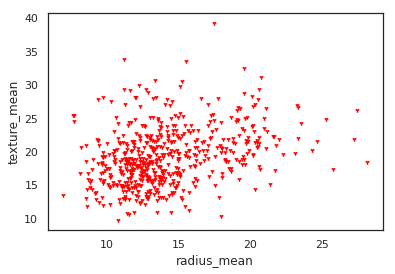

In [11]:
# The first way we can plot things is using the .plot extension from Pandas dataframes
# We'll use this to make a scatterplot of the cancer features.
Cancer.plot(kind="scatter", x="radius_mean", y="texture_mean", marker="1", color='red')

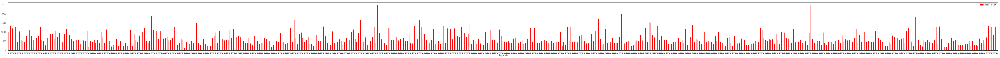

In [12]:
Cancer.plot(kind="bar", x="diagnosis", y="area_mean", color='red', figsize=(100,5))

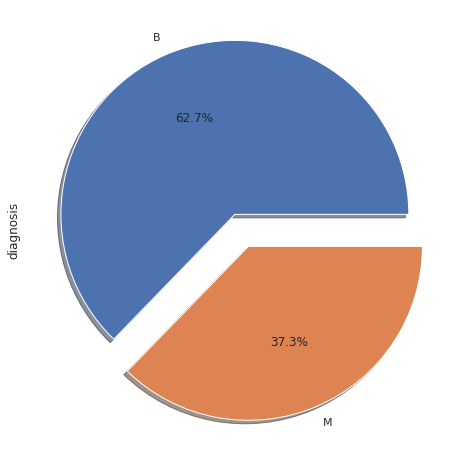

In [14]:
#f,ax=plt.subplots(1,2,figsize=(18,8))
Cancer['diagnosis'].value_counts().plot.pie(explode=[0.1,0.1 ],autopct='%1.1f%%',shadow=True,figsize=(10,8))
plt.show()

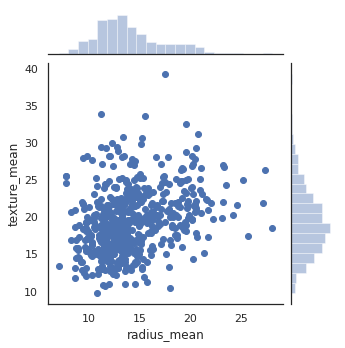

In [15]:
# A seaborn jointplot shows bivariate scatterplots and univariate histograms in the same figure
sns.jointplot(x="radius_mean", y="texture_mean", data=Cancer, size=5)

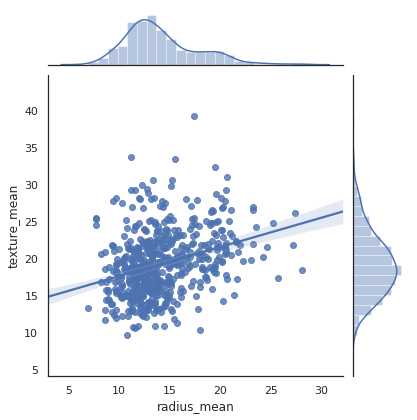

In [16]:
sns.jointplot(x="radius_mean", y="texture_mean", data=Cancer, kind="reg")

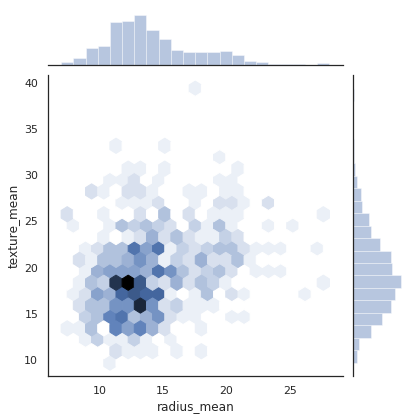

In [17]:
fig=sns.jointplot(x="radius_mean", y="texture_mean", kind='hex', data=Cancer)

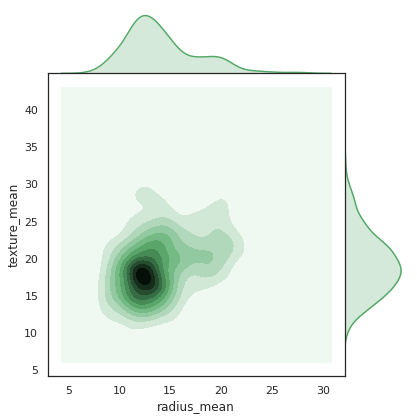

In [18]:
sns.jointplot(x="radius_mean", y="texture_mean", data=Cancer, kind="kde",space=0, color='g')

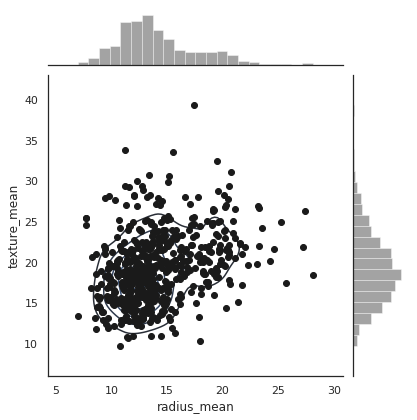

In [19]:
g = (sns.jointplot(x="radius_mean", y="texture_mean", data=Cancer, color="k").plot_joint(sns.kdeplot, zorder=0, n_levels=6))

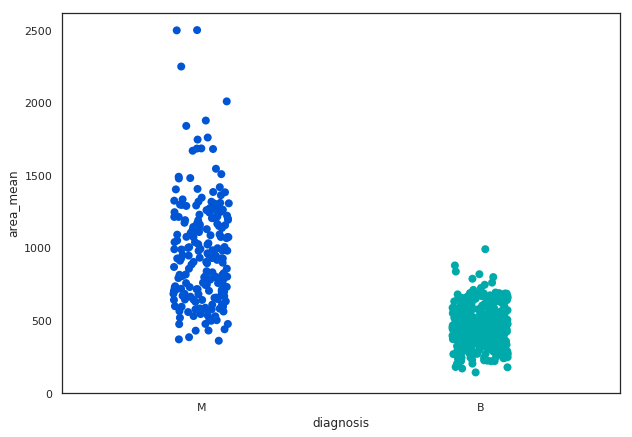

In [20]:
fig=plt.gcf()
fig.set_size_inches(10,7)
fig=sns.stripplot(x='diagnosis', y='area_mean', data=Cancer, jitter=True, edgecolor='gray',size=8, palette='winter', orient='v')

Text(0.5, 1.0, 'General Statistics of Cancer Dataset')

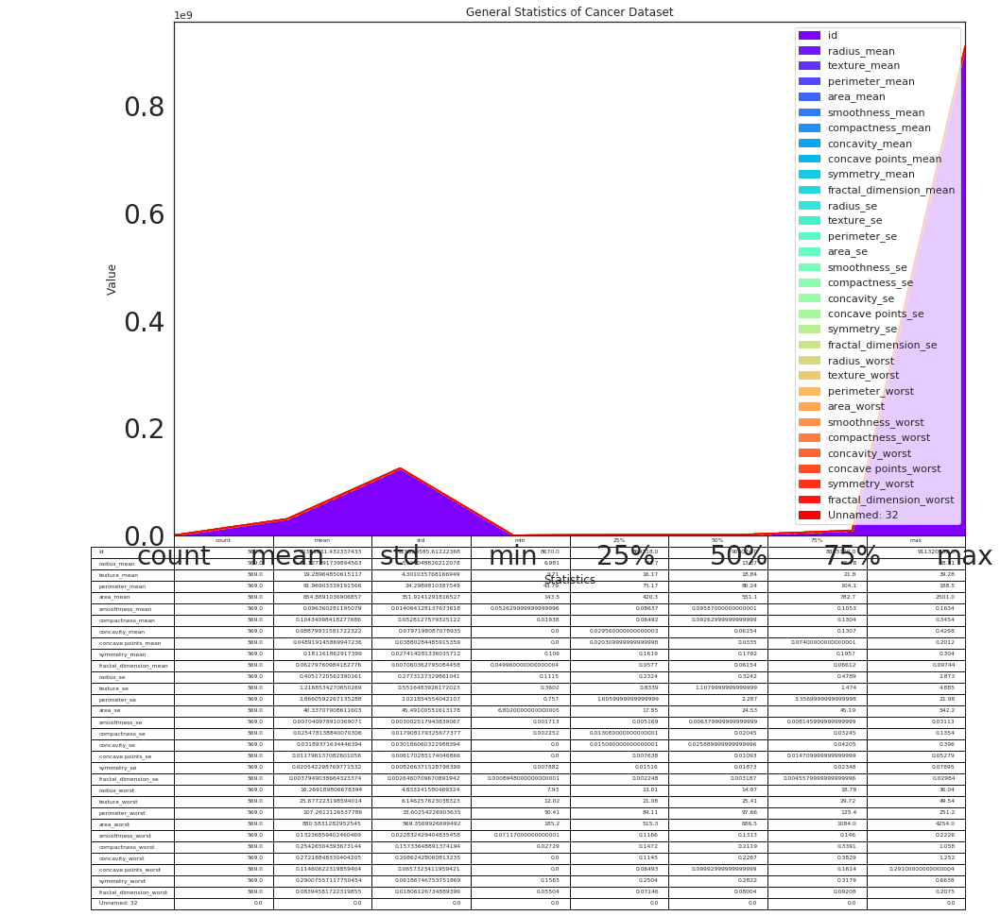

In [21]:
#Describing the data
Cancer.describe().plot(kind = "area", fontsize=28, figsize = (15,10), table = True, colormap="rainbow")
plt.xlabel('Statistics')
plt.ylabel('Value')
plt.title("General Statistics of Cancer Dataset")

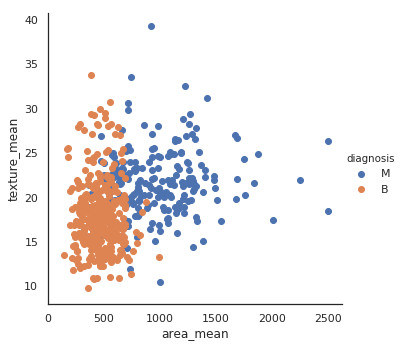

In [23]:
# One piece of information missing in the plots above is what is the category of each patient i.e, M or B 
# We'll use seaborn's FacetGrid to color the scatterplot by diagnosis
sns.FacetGrid(Cancer, hue="diagnosis", size=5) \
   .map(plt.scatter, "area_mean", "texture_mean") \
   .add_legend()

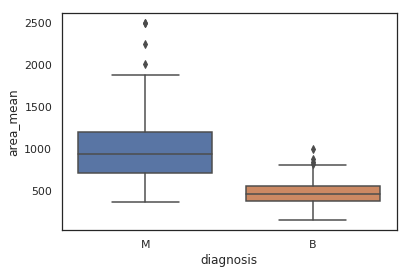

In [25]:
# We can look at an individual feature in Seaborn through a boxplot
sns.boxplot(x="diagnosis", y="area_mean", data=Cancer)

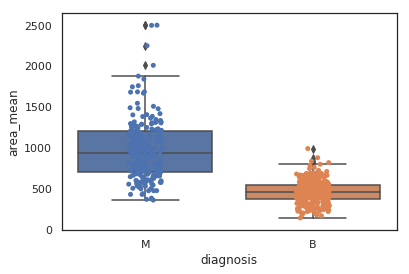

In [27]:
# One way we can extend this plot is adding a layer of individual points on top of
# it through Seaborn's striplot
# 
# We'll use jitter=True so that all the points don't fall in single vertical lines
# above the species
#
# Saving the resulting axes as ax each time causes the resulting plot to be shown
# on top of the previous axes
ax = sns.boxplot(x="diagnosis", y="area_mean", data=Cancer)
ax = sns.stripplot(x="diagnosis", y="area_mean", data=Cancer, jitter=True, edgecolor="gray")

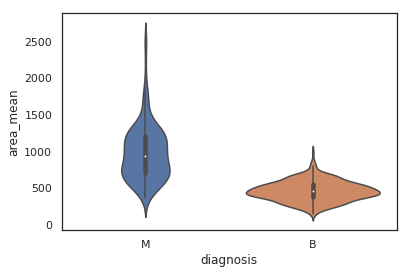

In [29]:
# A violin plot combines the benefits of the previous two plots and simplifies them
# Denser regions of the data are fatter, and sparser thiner in a violin plot
sns.violinplot(x="diagnosis", y="area_mean", data=Cancer, size=6)

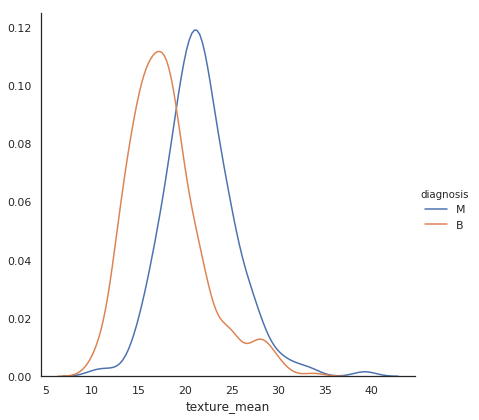

In [31]:
# A final seaborn plot useful for looking at univariate relations is the kdeplot,
# which creates and visualizes a kernel density estimate of the underlying feature
sns.FacetGrid(Cancer, hue="diagnosis", size=6) \
   .map(sns.kdeplot, "texture_mean") \
   .add_legend()

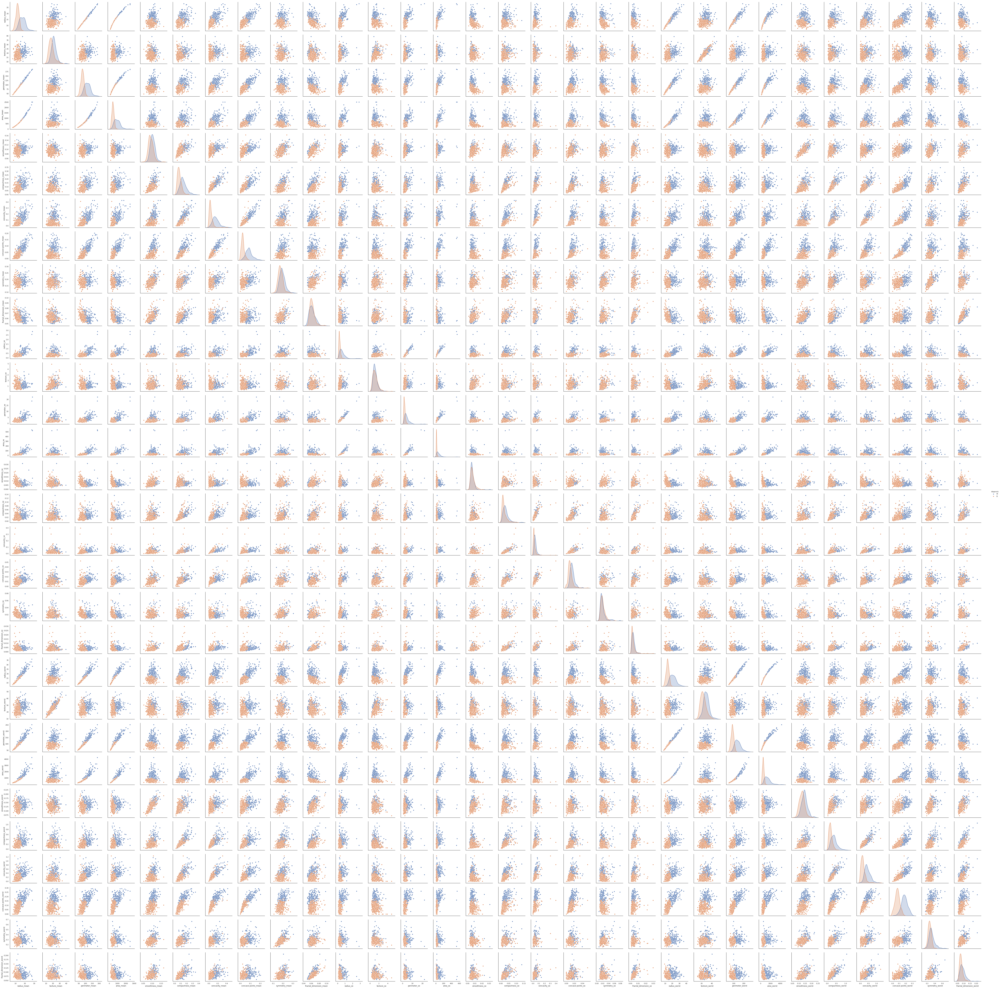

In [38]:
# Another useful seaborn plot is the pairplot, which shows the bivariate relation
# between each pair of features. From the pairplot, we'll see that the Iris-setosa species is separataed from the other
# two across all feature combinations
sns.pairplot(Cancer.drop(["id", "Unnamed: 32"], axis=1), hue="diagnosis", size=3)

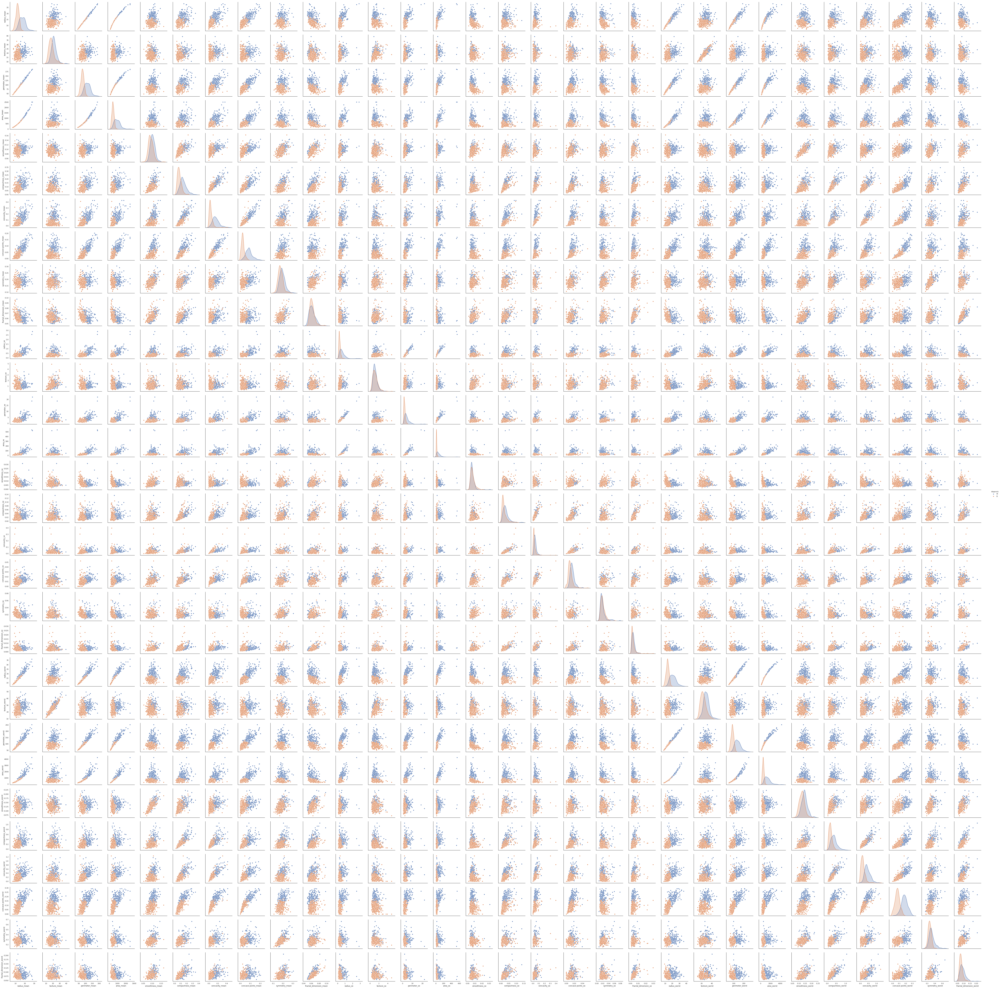

In [39]:
# The diagonal elements in a pairplot show the histogram by default
# We can update these elements to show other things, such as a kde
sns.pairplot(Cancer.drop(["id", "Unnamed: 32"], axis=1), hue="diagnosis", size=3, diag_kind="kde")

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7f1e8f2e3f60>,
      dtype=object)

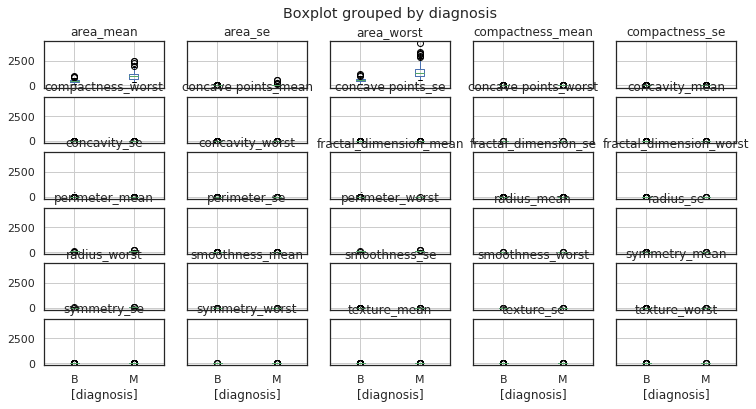

In [40]:
# Now that we've covered seaborn, let's go back to some of the ones we can make with Pandas
# We can quickly make a boxplot with Pandas on each feature split out by species
Cancer.drop(["id", "Unnamed: 32"], axis=1 ).boxplot(by="diagnosis", figsize=(12, 6))

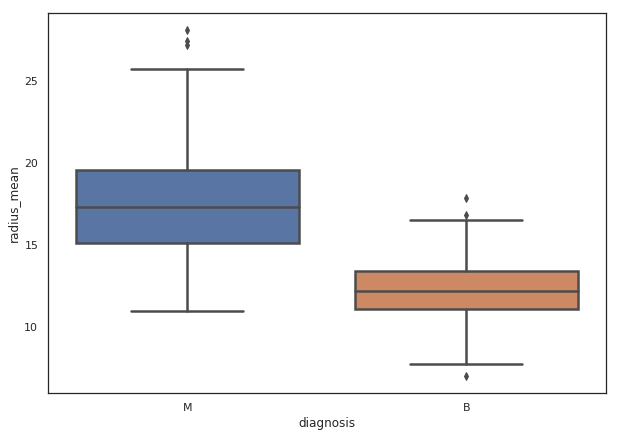

In [41]:
# Through sns
fig=plt.gcf()
fig.set_size_inches(10,7)
fig=sns.boxplot(x='diagnosis',y='radius_mean',data=Cancer , order=['M','B' ],linewidth=2.5,orient='v',dodge=False)

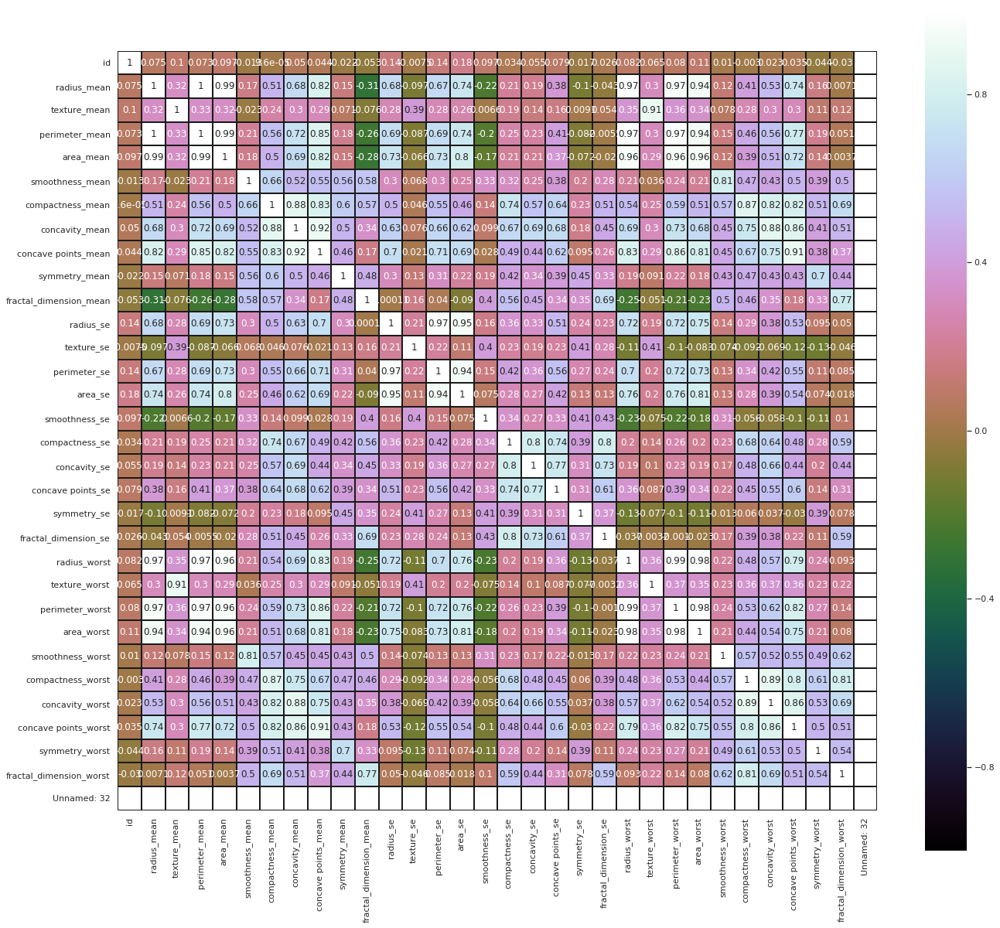

In [43]:
#Heat map Heat map is used to find out the correlation between different features in the dataset.
#High positive or negative value shows that the features have high correlation.
#This helps us to select the parmeters for machine learning.
fig=plt.gcf()
fig.set_size_inches(22,20)
fig=sns.heatmap(Cancer.corr(), annot=True, cmap='cubehelix',linewidths=1,linecolor='k',square=True,mask=False, vmin=-1, vmax=1,cbar_kws={"orientation": "vertical"},cbar=True)

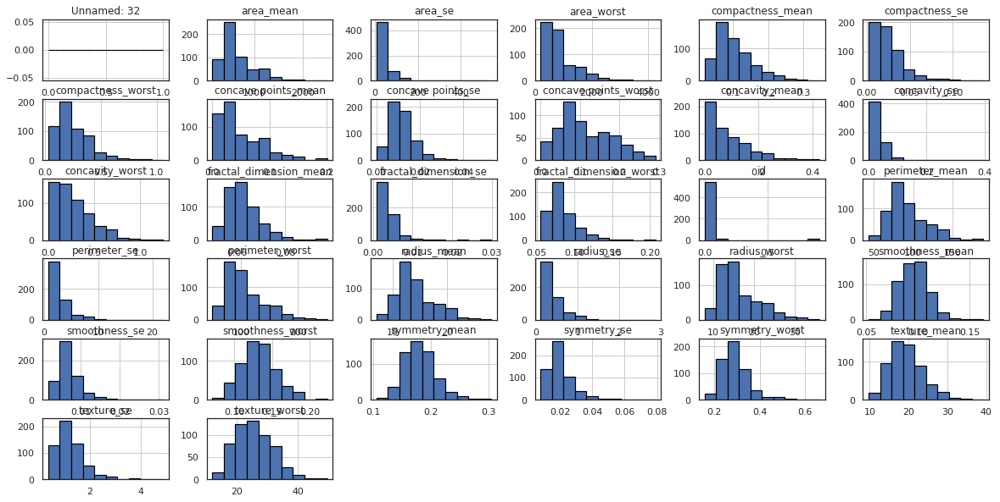

In [45]:
#The distribution plot is suitable for comparing range and distribution for groups of numerical data. 
#Data is plotted as value points along an axis. 
#You can choose to display only the value points to see the distribution of values, 
#a bounding box to see the range of values, or a combination of both as shown here.
#The distribution plot is not relevant for detailed analysis of the data as it deals with a summary of the data distribution.
Cancer.hist(edgecolor='black', linewidth=1.2)
fig=plt.gcf()
fig.set_size_inches(20,10)

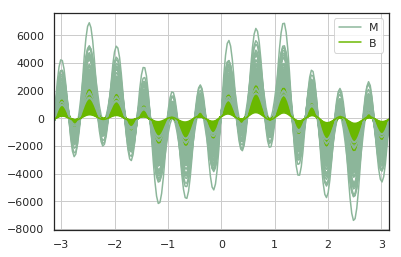

In [47]:
# One cool more sophisticated technique pandas has available is called Andrews Curves
# Andrews Curves involve using attributes of samples as coefficients for Fourier series
# and then plotting these.
# a smoothened version of a parallel coordinate plot.In Pandas use Andrews Curves to plot and visualize data structure.
# Each multivariate observation is transformed into a curve and represents the coefficients of a Fourier series.
from pandas.plotting import andrews_curves
andrews_curves(Cancer.drop(["id", "Unnamed: 32"], axis=1 ), "diagnosis")

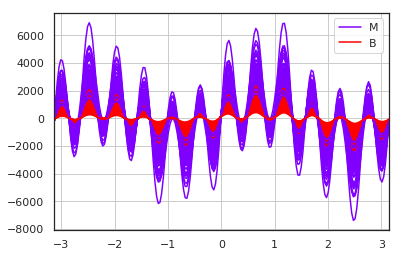

In [49]:
from pandas.plotting import andrews_curves
andrews_curves(Cancer.drop(["id", "Unnamed: 32"], axis=1 ), "diagnosis", colormap='rainbow')
plt.show()
plt.ioff()

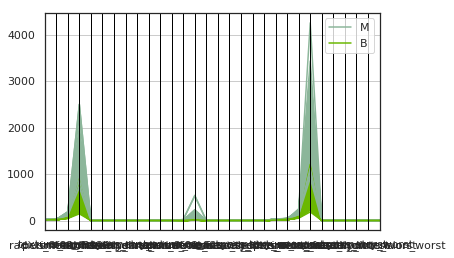

In [50]:
# Another multivariate visualization technique pandas has is parallel_coordinates
# Parallel coordinates plots each feature on a separate column & then draws lines
# connecting the features for each data sample
from pandas.plotting import parallel_coordinates
parallel_coordinates(Cancer.drop(["id", "Unnamed: 32"], axis=1 ), "diagnosis")

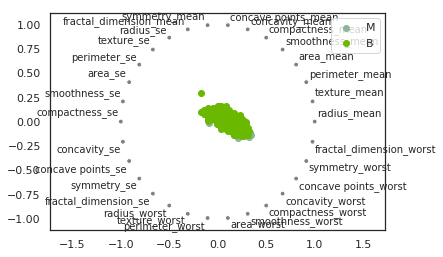

In [53]:
# A final multivariate visualization technique pandas has is radviz which puts each feature as a point on a 2D plane, 
# and then simulates having each sample attached to those points through a spring weighted by the relative value for that feature
from pandas.plotting import radviz
radviz(Cancer.drop(["id", "Unnamed: 32"], axis=1 ), "diagnosis" )

# Wrapping Up

I hope you enjoyed this quick introduction to some of the quick, simple data visualizations you can create with pandas, seaborn, and matplotlib in Python!

I encourage you to run through these examples yourself, tweaking them and seeing what happens. From there, you can try applying these methods to a new dataset and incorprating them into your own workflow!
 